In [1]:
import pandas as pd
import warnings
import plotly.express as px
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")

In [2]:
loaded = pd.read_parquet('final.parquet')
ORIGINAL_SIZE = loaded.shape[0]

# Question 1
## Can we detect places on the map that tend to have accidents more than other places? To answer this question we need to have latitude and longitude values for each accident.


### The dataset does not contain latitude and longitude. However it has northing and easting coordinates. We can use them to infer the latitude and longitude values.

## For this conversion we will use a library called convertbng
> https://pypi.org/project/convertbng/


In [3]:
from convertbng.util import convert_osgb36_to_lonlat
easting = loaded['location_easting_osgr'].tolist()
northing = loaded['location_northing_osgr'].tolist()
long, lat = convert_osgb36_to_lonlat(easting, northing)
loaded['longitude'] = long
loaded['latitude'] = lat

In [4]:
loaded[['latitude', 'longitude']].head()

,latitude,longitude
0,53.766278,-1.857516
1,56.611478,-2.917379
2,51.632471,-6.447135
3,54.224961,-6.155094
4,51.455082,-2.458051


### Let's add a density plot. This is useful when we want to check specific areas.

In [5]:
fig = px.density_mapbox(loaded, lat='latitude', lon='longitude', radius=10,opacity=0.9, 
                        center=dict(lat=51.5072, lon=0.1276), zoom=10,
                        mapbox_style="stamen-terrain")
fig.show()

-----------------------------------------------------------------------------

# Question 2

### Which regions in UK have the most accidents? (North, Mid North, Middle, Mid South, South).

In [6]:
max_lat = loaded['latitude'].max()
min_lat = loaded['latitude'].min()
labels = ['North', 'Mid North', 'Middle', 'Mid South', 'South']
intervals = np.linspace(min_lat, max_lat, 6)
intervals

array([49.81120813, 51.62463119, 53.43805424, 55.2514773 , 57.06490035,
       58.87832341])

In [7]:
loaded['Region'] = pd.cut(x=loaded['latitude'], bins=intervals, labels=labels, include_lowest=True)
loaded['Region'].value_counts()

Mid North    86417
North        72446
Middle       56437
Mid South    17603
South        13266
Name: Region, dtype: int64

In [8]:
loaded['Region'].head()

0       Middle
1    Mid South
2    Mid North
3       Middle
4        North
Name: Region, dtype: category
Categories (5, object): ['North' < 'Mid North' < 'Middle' < 'Mid South' < 'South']

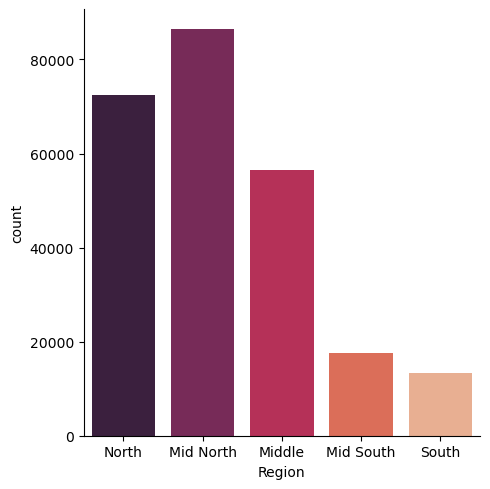

In [9]:
sns.catplot(data=loaded, x='Region', kind='count', palette='rocket')
plt.show()

In [10]:
loaded = pd.concat([ loaded, pd.get_dummies(loaded['Region']) ], axis=1 )
loaded.drop('Region', axis=1, inplace=True)

In [11]:
loaded.head()

,location_easting_osgr,location_northing_osgr,longitude,latitude,accident_severity,number_of_vehicles,number_of_casualties,speed_limit,pedestrian_crossing_physical_facilities,Week number,...,month,Afternoon,Dawn,Evening,Morning,North,Mid North,Middle,Mid South,South
0,409490.0,430000.0,-1.857516,53.766278,2,0.181818,0.000000,0.00,0.0,0.0,...,1,0,1,0,0,0,0,1,0,0
1,343790.0,747000.0,-2.917379,56.611478,2,0.090909,0.250000,0.25,0.0,0.0,...,1,0,1,0,0,0,0,0,1,0
2,92370.0,202000.0,-6.447135,51.632471,2,0.181818,0.250000,0.00,0.0,0.0,...,1,0,1,0,0,0,1,0,0,0
3,129270.0,489000.0,-6.155094,54.224961,2,0.181818,0.083333,0.00,0.0,0.0,...,1,0,1,0,0,0,0,1,0,0
4,368270.0,173000.0,-2.458051,51.455082,2,0.000000,0.000000,0.00,0.0,0.0,...,1,0,1,0,0,1,0,0,0,0


### Accidents are more common in North regions, followed by the Middle region.
------------------------------------------------------------------------

# Question 3

### Most accidents happen when there are non-normal conditions?

### To answer this question, let's add a new column 'normal_conditions' to indicate if a there was at least one non-normal condition associated with the given accident.

In [12]:
normal = (loaded['weather_conditions_Normal'] == 1) & (loaded['light_conditions_Normal'] == 1) & \
             (loaded['road_surface_conditions_Normal'] == 1) & (loaded['carriageway_hazards_Normal'] == 1) & \
             (loaded['junction_detail_Normal'] == 1)

loaded['normal_conditions'] = normal.astype(int)

### Now we can answer the questions using pie charts!

In [13]:
import plotly.graph_objects as go
import plotly.express as px
def pie_chart(labels, values, title):
    fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo='label+percent',)])
    fig.update_layout(
        title={
            'text': title,
            'y':0.9,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'})
    fig.update_traces(hoverinfo='label+percent',
                  marker=dict(colors=['', '#dd5f46']))

    fig.show()

def get_values(col_name):
    normal = loaded[col_name].sum()
    non_normal = ORIGINAL_SIZE - normal
    return [normal, non_normal]

### 83.2% of the accidents happend because of an existing non-normal condition.

In [14]:
labels = ["Normal Conditions", "Non-Normal Conditions"]
pie_chart(labels, get_values('normal_conditions'), "Percentage of Normal vs Non-Normal conditions.")

### Bad weather conditions resulted in 38.2% of the accidents.

In [15]:
labels = ["Normal Weather Conditions", "Non-Normal Weather Conditions"]
pie_chart(labels, get_values('weather_conditions_Normal'), title="Percentage of Normal vs Non-Normal Weather Conditions.")

### Light conditions don't seem to be affecting accidents that much!

In [16]:
labels = ["Normal Light Conditions", "Non-Normal Light Conditions"]
pie_chart(labels, get_values('light_conditions_Normal'), title="Percentage of Normal vs Non-Normal Light Conditions.")

### 37.3% of the accidents have non-normal road surface conditions.

In [17]:
labels = ["Normal Road Surface Conditions", "Non-Normal Road Surface Conditions"]
pie_chart(labels, get_values('road_surface_conditions_Normal'), title="Percentage of Normal vs Non-Normal Road Surface Conditions.")

### Carrigeway conditions don't seem to be playing an effective role!

In [18]:
labels = ["Normal Carriageway Conditions", "Non-Normal Carriageway Conditions"]
pie_chart(labels, get_values('carriageway_hazards_Normal'), title="Percentage of Normal vs Non-Normal Carrigeway Conditions.")

### More than half the accidents happend in junctions.

In [19]:
labels = ["No Junction", "Has Junction"]
pie_chart(labels, get_values('junction_detail_Normal'), title="Percentage of No Junction vs Junction.")

In [20]:
junction_filter = loaded['junction_detail_Normal'] == 0
junction = junction_filter.sum()

weather_filter = (~junction_filter) & (loaded['weather_conditions_Normal'] == 0)
weather = weather_filter.sum()

light_filter = (~junction_filter) & (~weather_filter) & (loaded['light_conditions_Normal'] == 0)
light = light_filter.sum()

road_filter = (~junction_filter) & (~weather_filter) & (~light_filter) & (loaded['road_surface_conditions_Normal'] == 0)
road = road_filter.sum()

carriageway_filter = (~junction_filter) & (~weather_filter) & (~light_filter) & (~road_filter) & (loaded['carriageway_hazards_Normal'] == 0)
carriageway = carriageway_filter.sum()

normal_accidents_count = loaded['normal_conditions'].sum()
non_normal_accidents_count = ORIGINAL_SIZE - normal_accidents_count

In [21]:
fig = go.Figure(go.Sunburst(
    labels=["Normal Conditions", "Non-Normal Conditions", "Junction", "Weather", 'Lights', 'Road', 'Carriageway'],
    parents=["", "", "Non-Normal Conditions", "Non-Normal Conditions", "Non-Normal Conditions", "Non-Normal Conditions", "Non-Normal Conditions"],
    values=[normal_accidents_count, non_normal_accidents_count, junction, weather, light, road, carriageway],
    textinfo='label+percent parent',
    branchvalues='total'
))
fig.update_layout(margin = dict(t=50, l=0, r=0, b=0),  title={
            'text': 'Percentage of Normal vs Non-Normal Conditions and sub-categories',
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'})


fig.show()

In [22]:
loaded.to_parquet('final_MS2.parquet')